<p align = "center" draggable=”false” ><img src="https://user-images.githubusercontent.com/37101144/161836199-fdb0219d-0361-4988-bf26-48b0fad160a3.png" 
     width="200px"
     height="auto"/>
</p>

# Hate Speech Detector

Today you are a machine learning engineer, a member of the Birdwatch at Twitter. 

The objective of this task is to detect hate speech in tweets. For the sake of simplicity, a tweet contains hate speech if it has a racist or sexist sentiment associated with it. In other words, we need to classify racist or sexist tweets from other tweets.

A labelled dataset of 31,962 tweets (late 2017 to early 2018) is provided in the form of a compressed csv file with each line storing a tweet id, its label, and the tweet. Label '1' denotes the tweet is racist/sexist while label '0' denotes the tweet is not racist/sexist.

We will first approach the problem in a traditional approach: clean the raw text using simple regex (regular expression), extract features, build a naive Bayes models to classify tweets; then we build a deep learning model and explain our deep learning model with LIME.

## 📚 Learning Objectives

By the end of this lesson, you will be able to:

- Understand the basic concepts in natural language processing (NLP)
- Perform basic NLP tasks on text, e.g., tweets
- Build a naive Bayes classifier to detect hate speech 
- Build a bidirectional long short-term memory (BiLSTM) to detect hate speech
- Visualize embeddings with Tensorboard embedding projector
- Explain models with LIME

# Task I: Data Preprocessing


1. Install dependencies.

    Most modules are pre-installed in Colab, however, we need to update `gensim` to its recent version and install `lime`.

In [1]:
!pip install -U -q gensim==4.2.0 lime

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 24.1/24.1 MB 29.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 275.7/275.7 KB 15.7 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done


In [2]:
from google.colab import files
uploaded = files.upload()

Saving tweets.csv.gz to tweets.csv.gz


2. Connect Colab to your local Google Drive.

In [ ]:
# from google.colab import drive
# drive.mount('/content/drive')

3. Use `pandas.read_csv` to load the tweets in `tweets.csv.gz` and save the `pd.DataFrame` into `raw`. Make sure the path points to where the data is located in your Google Drive. 

In [61]:
# YOUR CODE HERE
import pandas as pd
raw = pd.read_csv('tweets.csv.gz') 

In [5]:
print(raw.info())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 31962 entries, 0 to 31961
Data columns (total 3 columns):
 #   Column  Non-Null Count  Dtype 
---  ------  --------------  ----- 
 0   id      31962 non-null  int64 
 1   label   31962 non-null  int64 
 2   tweet   31962 non-null  object
dtypes: int64(2), object(1)
memory usage: 749.2+ KB
None


4. Sample 5 random tweets from the dataset for each label and display `label` and `tweet` columns. 
Hint: one option is to use `sample()` followed by `groupby`. 

In [62]:
# Colab includes an extension that renders pandas dataframes into interactive displays that can be filtered, sorted, and explored dynamically.
from google.colab import data_table
data_table.enable_dataframe_formatter() 

# YOUR CODE HERE

# sample 5 tweets for each label
sampled_raw = raw.groupby('label').apply(lambda x: x.sample(n=5)).reset_index(drop=True)

# display the sampled tweets
data_table.DataTable(sampled_raw[['id','label', 'tweet']])

,id,label,tweet
0,24470,0,@user i just hit rock bottom. watching guys p...
1,19236,0,@user just booked tickets for the hungarian g...
2,5310,0,beð ð@user @user @user @user @user @user...
3,6855,0,fathers day#come on fattyð¬ð§
4,26861,0,@user just wondering when the next book in the...
5,31604,1,girl get fuck bondage leather girl
6,21623,1,free girls pic galery girls fucked
7,7216,1,you might be a libtard if... #libtard #sjw #l...
8,6380,1,thought factory: left-right polarisation! #tru...
9,23424,1,@user a #nation should not be #judged by how i...


5. The tweets are in English and all words should be already in lowercase. 
Now calculate the number of characters in each tweet and assign the values to a new column `len_tweet` in `raw`. 

In [63]:
# YOUR CODE HERE
raw['len_tweet'] = raw['tweet'].apply(lambda x: len(x))
raw.head()

,id,label,tweet,len_tweet
0,1,0,@user when a father is dysfunctional and is s...,102
1,2,0,@user @user thanks for #lyft credit i can't us...,122
2,3,0,bihday your majesty,21
3,4,0,#model i love u take with u all the time in ...,86
4,5,0,factsguide: society now #motivation,39


6. What are the summary statistics of `len_tweet` for each label? 
Hint: use `groupby` and `describe`. 

In [64]:
pd.set_option("display.precision", 1)

# YOUR CODE HERE
summary_stats = raw.groupby('label')['len_tweet'].describe()
print(summary_stats)


         count  mean   std   min   25%   50%    75%    max
label                                                     
0      29720.0  84.3  29.6  11.0  62.0  88.0  107.0  274.0
1       2242.0  90.2  27.4  12.0  69.0  96.0  111.0  152.0


Note we have an imbalanced dataset: the ratio of non-hate speech to hate speech is roughly 13:1. 

7. Clean the tweets. 

    We use `re` to perform basic text manipulations. 
    Specically, remove anonymized user handle, remove numbers and special characters except hashtags.

In [12]:
import re

8. Remove user handles from the text in `tweet`, or anything directly following the symbols `@`, and save the resulting tweets to a new column `tidy_tweet` in `raw`. 
    
    Hint: you can use `re.sub` on individual text and [`apply`](https://pandas.pydata.org/docs/reference/api/pandas.DataFrame.apply.html) a simple lambda function for the series `raw['tweet']`.

In [65]:
# define a function to remove user handles from the text
def remove_user_handles(text):
    return re.sub(r'@\w+', '', text)

# apply the function to the 'tweet' column and save the resulting tweets to a new column 'tidy_tweet'
raw['tidy_tweet'] = raw['tweet'].apply(lambda x: remove_user_handles(x))# YOUR CODE HERE

In [66]:
raw.sample(5, random_state=203)

,id,label,tweet,len_tweet,tidy_tweet
790,791,1,@user and you keep telling that only aryans ar...,109,and you keep telling that only aryans are all...
21928,21929,0,@user what makes you ?,25,what makes you ?
25642,25643,0,"â #nzd/usd extends rbnz-led rally, hits fre...",101,"â #nzd/usd extends rbnz-led rally, hits fre..."
20436,20437,0,i'm on a mission to ride all of the animals! ...,91,i'm on a mission to ride all of the animals! ...
22552,22553,0,the color of a human skin matters a lot to the...,88,the color of a human skin matters a lot to the...


9. Remove non-alphabetic characters yet keep symbols `#` from `tidy_tweet` and save the result in `tidy_tweet`. 
In other words, keep all 26 letters and `#`.

    Note: in some applications, punctuations, emojis, or whether the word is in all caps can be of use. 
    You shall decide whether to extract such features for the application and perform error analysis to gain insight. 

In [67]:
def clean_tweet(text):
    text = re.sub(r'@[A-Za-z0-9_]+', '', text) # remove user handles
    text = re.sub(r'[^a-zA-Z#\s]', '', text) # remove non-alphabetic characters except #
    return text

In [68]:
#replacing any character that is not a letter or # symbol with an empty string
raw['tidy_tweet'] = raw['tweet'].apply(lambda x: clean_tweet(x)) # YOUR CODE HERE
raw.sample(5, random_state=203)

,id,label,tweet,len_tweet,tidy_tweet
790,791,1,@user and you keep telling that only aryans ar...,109,and you keep telling that only aryans are all...
21928,21929,0,@user what makes you ?,25,what makes you
25642,25643,0,"â #nzd/usd extends rbnz-led rally, hits fre...",101,#nzdusd extends rbnzled rally hits fresh yea...
20436,20437,0,i'm on a mission to ride all of the animals! ...,91,im on a mission to ride all of the animals #...
22552,22553,0,the color of a human skin matters a lot to the...,88,the color of a human skin matters a lot to the...


10. Remove words that is shorter than 4 characters from the processed tweets.

    For example, 
      
    `i m on a mission to ride all of the animals #teamchanlv #vegas #lasvegas #funtimes`
      
    will be reduced to 
      
    `mission ride animals #teamchanlv #vegas #lasvegas #funtimes`


In [69]:
raw['tidy_tweet'] = raw['tidy_tweet'].apply(lambda x: ' '.join([w for w in re.split(r'\s+', x) if len(w) >= 4]))# YOUR CODE HERE
raw.sample(5, random_state=203)

,id,label,tweet,len_tweet,tidy_tweet
790,791,1,@user and you keep telling that only aryans ar...,109,keep telling that only aryans allowed rape wom...
21928,21929,0,@user what makes you ?,25,what makes
25642,25643,0,"â #nzd/usd extends rbnz-led rally, hits fre...",101,#nzdusd extends rbnzled rally hits fresh year ...
20436,20437,0,i'm on a mission to ride all of the animals! ...,91,mission ride animals #teamchanlv #vegas #lasve...
22552,22553,0,the color of a human skin matters a lot to the...,88,color human skin matters system when comes jud...


11. Remove stopwords and perform text normalization. 
    
    We will use `stopwords` collection and `SnowballStemmer` in `nltk` for this task. Before doing so, we need to tokenize the tweets. 
    Tokens are individual terms or words, and tokenization is simply to split a string of text into tokens. 
    You can use [`str.split()`](https://docs.python.org/3/library/stdtypes.html#str.split) on individual text and [`apply`](https://pandas.pydata.org/docs/reference/api/pandas.DataFrame.apply.html) a simple lambda function for the series `raw['tidy_tweet']` and save the result into `tokenized_tweet`. 
    
    Check out some methods for the built-in type `str` [here](https://docs.python.org/3/library/stdtypes.html#string-methods).

In [70]:
tokenized_tweet = raw['tidy_tweet'].apply(lambda x: x.split())# YOUR CODE HERE
tokenized_tweet.head()

0    [when, father, dysfunctional, selfish, drags, ...
1    [thanks, #lyft, credit, cant, cause, they, don...
2                              [bihday, your, majesty]
3                     [#model, love, take, with, time]
4                   [factsguide, society, #motivation]
Name: tidy_tweet, dtype: object

12. Extract stop words and remove them from the tokens.

    Note: depending on the task / industry, it is highly recommended that one curate custom stop words. 

In [71]:
import nltk
nltk.download('stopwords')
from nltk.corpus import stopwords
stop_words = stopwords.words('english')

[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


In [72]:
tokenized_tweet =  tokenized_tweet.apply(lambda x: [i for i in x if i not in stop_words])# YOUR CODE HERE
tokenized_tweet

0        [father, dysfunctional, selfish, drags, kids, ...
1        [thanks, #lyft, credit, cant, cause, dont, off...
2                                        [bihday, majesty]
3                               [#model, love, take, time]
4                       [factsguide, society, #motivation]
                               ...                        
31957                                              [youuu]
31958    [nina, turner, airwaves, trying, wrap, mantle,...
31959            [listening, songs, monday, morning, work]
31960    [#sikh, #temple, vandalised, #calgary, #wso, c...
31961                                      [thank, follow]
Name: tidy_tweet, Length: 31962, dtype: object

In [74]:
assert any(word in tokenized_tweet for word in stop_words) == False

13. Create a new instance of a language specific [`SnowballStemmer`](https://www.nltk.org/api/nltk.stem.snowball.html), set the `language` to be "english"; see [how to](https://www.nltk.org/howto/stem.html). 

In [73]:
# Define the Snowball Stemmer for English
from nltk.stem.snowball import SnowballStemmer
stemmer = SnowballStemmer("english")# YOUR CODE HERE

In [76]:
tokenized_tweet = tokenized_tweet.apply(lambda x: [stemmer.stem(i) for i in x]) 
tokenized_tweet.head()

0    [father, dysfunct, selfish, drag, kid, dysfunc...
1    [thank, #lyft, credit, cant, caus, dont, offer...
2                                    [bihday, majesti]
3                           [#model, love, take, time]
4                         [factsguid, societi, #motiv]
Name: tidy_tweet, dtype: object

14. Lastly, let's stitch these tokens in `tokenized_tweet` back together and save them in `raw['tidy_tweet']`. 
Use [`str.join()`](https://docs.python.org/3/library/stdtypes.html#str.join) and `apply`.

In [77]:
raw['tidy_tweet'] =tokenized_tweet.apply(lambda x: ' '.join(x)) # YOUR CODE HERE
raw['tidy_tweet']

0           father dysfunct selfish drag kid dysfunct #run
1        thank #lyft credit cant caus dont offer wheelc...
2                                           bihday majesti
3                                    #model love take time
4                                 factsguid societi #motiv
                               ...                        
31957                                                youuu
31958    nina turner airwav tri wrap mantl genuin hero ...
31959                         listen song monday morn work
31960          #sikh #templ vandalis #calgari #wso condemn
31961                                         thank follow
Name: tidy_tweet, Length: 31962, dtype: object

# Task 2. Wordcloud and Hashtag

In this task, we want to gain a general idea of what the common words were and how hashtags were used in tweets. 
We will create wordclouds and extract the top hashtags used in each label. 

1. Before doing so, out of caution of possible data leakage, split the `raw['tidy_tweet']` into training and test datasets in a stratified fashion, set the test size at .25 and random state as 42.
    
    Save the results into `X_train`, `X_test`, `y_train`, and `y_test`.

In [78]:
from sklearn.model_selection import train_test_split

X_train, X_test, y_train, y_test = train_test_split(
    raw['tidy_tweet'], raw.label, 
    test_size=0.25, random_state=42, stratify=raw.label)

In [79]:
assert X_train.shape == y_train.shape == (23971, )
assert X_test.shape == y_test.shape == (7991,)

2. A word cloud is a cluster of words depicted in different sizes. 
The bigger the word appears, the more often it appears in the given text. 
It can offer an easy visual presentation to reveal the theme of a topic. 

    Function `plot_wordcloud` is provided to plot 50 most frequent words from the given text in the shape of twitter's logo. 
    You may need to replace the image path accordingly.

In [81]:
from wordcloud import WordCloud
import matplotlib.pyplot as plt
import numpy as np
from PIL import Image

def plot_wordcloud(text:str) -> None:
    '''
    Plot a wordcloud of top 50 words from the input text
    masked by twitter logo
    '''
    mask = np.array(Image.open('/content/twitter-mask.png')) # REPLACE w/ YOUR FILE PATH
    wordcloud = WordCloud( 
        background_color='white', 
        random_state=42,
        max_words=50, 
        max_font_size=80, 
        mask = mask).generate(text)
    plt.figure(figsize=(10,10))
    plt.imshow(wordcloud, interpolation="bilinear")
    plt.axis("off")
    plt.show()

3. Visualize the wordcloud. 

    The function expects one long string. 
    Stitch all tidy tweets from training set and save the single string to `all_words`, then visualize the wordcloud for all the words.

In [82]:
all_words =  ' '.join(X_train)# YOUR CODE HERE

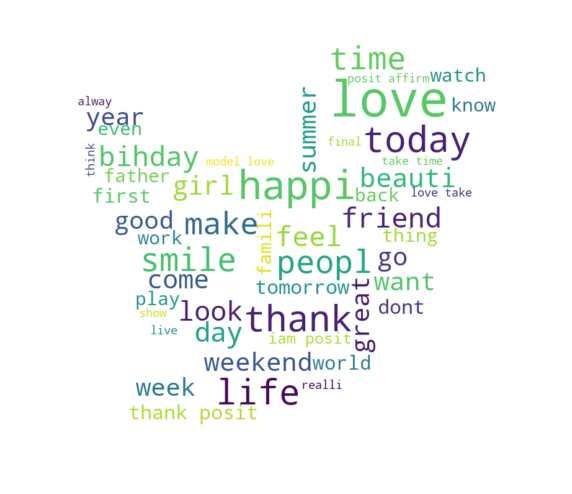

In [83]:
plot_wordcloud(all_words)

4. Visualize the wordcloud just for the text from the tweets identified as hate speech. 

    Similarly, you need to stitch all the tidy tweets in training set that were identified as hate speech. 
    Save the long string to `negative_words`.

In [84]:
# Get indices of tweets identified as hate speech
hate_speech_indices = y_train[y_train == 1].index

In [85]:
negative_words = ' '.join([X_train[i] for i in hate_speech_indices]) # YOUR CODE HERE

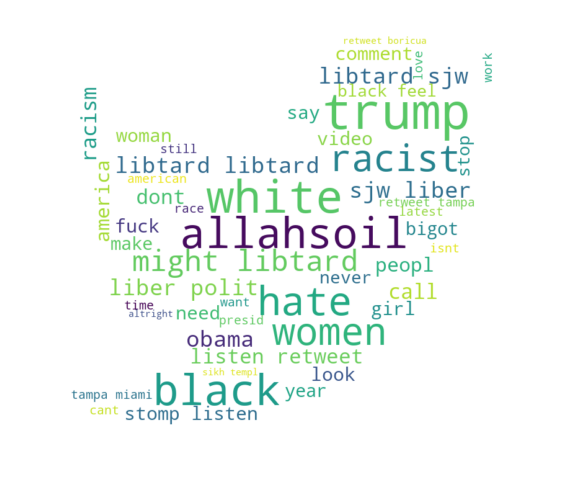

In [114]:
plot_wordcloud(negative_words)

5. Hashtag is a feature for tweets and we would like to inspect if hashtags provide information for our classification task. 

    Function `hashtag_extract` is provided to extract hastags from an iterable (list or series) and return the hashtags in a list. 

In [115]:
def hashtag_extract(x) -> list:
    """
    extract hastags from an iterable (list or series) and 
    return the hashtags in a list.
    """
    hashtags = []
    # Loop over the words in the tweet
    for i in x:
        ht = re.findall(r"#(\w+\d*\w*)", i)
        # ht = re.findall(r"#(\w+)", i)
        hashtags.append(ht)
    return hashtags

6. Extract hashtags from non-hate speech tweets.

In [116]:
# Get indices of tweets identified as non-hate speech
non_hate_speech_indices = y_train[y_train == 0].index

In [117]:
HT_regular = hashtag_extract([X_train[i] for i in non_hate_speech_indices])# YOUR CODE HERE

In [ ]:
#HT_regular

In [118]:
assert type(HT_regular) == list
assert type(HT_regular[0]) == list # nested list

7. Now extract hashtags from hate speech tweets.

In [119]:
HT_negative = hashtag_extract([X_train[i] for i in hate_speech_indices])# YOUR CODE HERE

In [111]:
# HT_negative

8. Both `HT_regular` and `HT_negative` are nested lists, so use the following trick to unnest both lists.

In [120]:
HT_regular = sum(HT_regular,[])
HT_negative = sum(HT_negative,[])

In [121]:
assert type(HT_regular) == type(HT_negative) == list
assert type(HT_regular[0]) == type(HT_negative[0]) == str

9. Complete the function `top_hashtags` below to take a list of hashtags and return the top `n` hashtag keyword and its frequncy. 

In [125]:
from typing import List, Tuple
from collections import Counter
def top_hashtags(hashtags: List[str], n: int = 10) -> List[Tuple[str, int]]:
    ''' Function to return the top n hashtags '''
    counter = Counter(hashtags)
    return counter.most_common(n)

1. Apply the function to the hashtag lists from the non-hate speech tweets and the hate speech tweets.

In [128]:
# YOUR CODE HERE
print("Top 10 hashtags from non-hate speech tweets:")
top_ht_regular = top_hashtags(HT_regular)
print(top_n_ht_regular)



Top 10 hashtags from non-hate speech tweets:
[('love', 1234), ('posit', 693), ('smile', 513), ('healthi', 422), ('thank', 398), ('fun', 345), ('life', 327), ('affirm', 324), ('summer', 288), ('model', 284)]


In [129]:
# YOUR CODE HERE
print("\nTop 10 hashtags from hate speech tweets:")
top_ht_negative = top_hashtags(HT_negative)
print(top_n_ht_negative)



Top 10 hashtags from hate speech tweets:
[('trump', 97), ('allahsoil', 77), ('polit', 73), ('liber', 62), ('libtard', 57), ('sjw', 56), ('retweet', 50), ('miami', 37), ('black', 36), ('hate', 28)]


10. DISCUSS: are these hashtags making sense? should we include them as features or should we strip the # before tokenizing (that is, treat "#love" the same as "love")? why and why not?
          #YOUR ANSWER HERE


*Looking at the top hashtags from non-hate speech tweets, they seem to represent positive sentiments such as love, positivity, health, and fun. These hashtags could potentially add value as features in the model as they provide additional context to the text data.

On the other hand, the top hashtags from hate speech tweets seem to be politically charged and contain offensive language. Using these hashtags as features may not be appropriate as they could contribute to model bias and negatively affect the model's performance. In addition, since hashtags are not always representative of the entire tweet, it may be better to strip the "#" before tokenizing so that the hashtags are treated the same as regular words in the text data.*

# Task 3. Features

Note that almost all the machine learning related Python modules expect numerical presentation of data; thus we need to transform our text first.
We will experiment with bag of words, tf-idf, and word2vec.  

1. Convert the collection of text documents to a matrix of token counts.

    Check the [official documentation](https://scikit-learn.org/stable/modules/generated/sklearn.feature_extraction.text.CountVectorizer.html). 
    
    Create an instance of `CountVectorizer` named `bow_vectorizer`, set `max_features` to be `MAX_FEATURES`.
    Learn the vocabulary dictionary and return document-term matrix and save it to `bow_train`. Use `.fit_transform`. 

In [130]:
from sklearn.feature_extraction.text import CountVectorizer
MAX_FEATURES = 1000

# Initialize the CountVectorizer
bow_vectorizer = CountVectorizer(max_features=MAX_FEATURES) # YOUR CODE HERE
# Learn the vocabulary dictionary and return the document-term matrix
bow_train =bow_vectorizer.fit_transform(X_train) # YOUR CODE HERE

In [131]:
assert bow_train.shape == (X_train.shape[0], MAX_FEATURES)

2. Print the first three rows from `bow_train`. Hint: `.toarray()`.

In [132]:
print(bow_train.toarray()[:3])# YOUR CODE HERE

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]


In [133]:
from scipy.sparse.csr import csr_matrix
assert type(bow_train) == csr_matrix

3. Similarly, convert the collection of text documents to a matrix of TF-IDF features.
    
    Create an instance of [`TfidfVectorizer`](https://scikit-learn.org/stable/modules/generated/sklearn.feature_extraction.text.TfidfVectorizer.html#sklearn.feature_extraction.text.TfidfVectorizer) named `tfidf_vectorizer`, set `max_features` to be `MAX_FEATURES`.

    Learn the vocabulary and idf, return document-term matrix and save it to `tfidf_train`. 

In [134]:
from sklearn.feature_extraction.text import TfidfVectorizer

In [135]:
tfidf_vectorizer = TfidfVectorizer(max_features=MAX_FEATURES)# YOUR CODE HERE
tfidf_train = tfidf_vectorizer.fit_transform(X_train)

In [136]:
assert type(tfidf_train) == csr_matrix
assert tfidf_train.shape == bow_train.shape == (X_train.shape[0], MAX_FEATURES)

4. Extract word embeddings using Word2Vec. 
We will use [`gensim`](https://radimrehurek.com/gensim/auto_examples/tutorials/run_word2vec.html) for this task. 
    
    The Word2Vec model takes either a list of lists of tokens or an iterable that streams the sentences directly from disk/network. 
    Here, we tokenize the tidy tweets in `X_train` and save the list (`pd.series`) of lists of tokens to `tokenized_tweet`. 

In [138]:

nltk.download('punkt')  # Download the required tokenizer


[nltk_data] Downloading package punkt to /root/nltk_data...
[nltk_data]   Unzipping tokenizers/punkt.zip.


True

In [139]:
tokenized_tweet =  X_train.apply(nltk.word_tokenize)# YOUR CODE HERE

In [140]:
assert tokenized_tweet.shape == X_train.shape

In [141]:
tokenized_tweet.head()

1036     [like, spread, peanut, butter, white, bread, #...
2380     [watch, made, america, simpson, interest, went...
31605    [franci, underwood, seen, leav, marseill, #, n...
23437    [#, enjoy, #, music, #, today, #, free, #, app...
2669     [#, juic, experi, #, notsobad, #, healthyliv, ...
Name: tidy_tweet, dtype: object

5. Import `Word2Vec` from `gensim.models`; see [doc](https://radimrehurek.com/gensim/models/word2vec.html#gensim.models.word2vec.Word2Vec). 

    Create a skip-gram `Word2Vec` instance named `w2v` that learns on the `tokenized_tweet`, with `vector_size` set at `MAX_FEATURES`, and other parameters are provided. 

In [142]:
from gensim.models import Word2Vec

In [143]:
w2v = Word2Vec(
        tokenized_tweet,  
        vector_size =1000,# YOUR CODE HERE
        window=5, min_count=2, sg = 1, 
        hs = 0, negative = 10,  workers= 2, 
        seed = 34)

6. Train the skip-gram model, set the epochs at 20.

In [144]:
%%time
# YOUR CODE HERE
w2v.train(tokenized_tweet, total_examples=len(tokenized_tweet), epochs=20)


CPU times: user 1min 43s, sys: 236 ms, total: 1min 43s
Wall time: 1min 1s


(2924644, 4407260)

7. Let's see how the model performs. 
Specify a word and print out the 10 most similar words from the our tweets in the training set. 
Use [`most_similar`](https://radimrehurek.com/gensim/models/keyedvectors.html#gensim.models.keyedvectors.KeyedVectors.most_similar). 
Hint: print the type of `w2v` and `w2v.wv`.

In [145]:
# YOUR CODE HERE
# specify a word
word = "love"

# print type of w2v and w2v.wv
print(type(w2v))
print(type(w2v.wv))

# print the 10 most similar words
similar_words = w2v.wv.most_similar(word, topn=10)
print(f"The 10 most similar words to '{word}' are:")
for i, (word, score) in enumerate(similar_words):
    print(f"{i+1}. {word} (score={score:.2f})")

<class 'gensim.models.word2vec.Word2Vec'>
<class 'gensim.models.keyedvectors.KeyedVectors'>
The 10 most similar words to 'love' are:
1. ciao (score=0.54)
2. chess (score=0.52)
3. instafun (score=0.52)
4. l (score=0.52)
5. newlyw (score=0.51)
6. latergram (score=0.51)
7. ramadhan (score=0.51)
8. positivevibeson (score=0.51)
9. ownit (score=0.51)
10. chita (score=0.51)


8. Discuss: how does w2v calculate the similarities? 

  YOUR ANSWER HERE

9. Discuss: do you think Word2Vec is supervised or unsupervised ML technique?

    YOUR ANSWER HERE Word2Vec calculates similarities between words using the cosine similarity measure. The cosine similarity between two vectors is a measure of their similarity, where the angle between the two vectors is computed. The cosine similarity ranges from -1 to 1, where -1 indicates that the two vectors are completely dissimilar, 0 indicates no similarity, and 1 indicates that the two vectors are identical. In the case of Word2Vec, each word in the vocabulary is represented by a high-dimensional vector, and similarities between words are calculated by taking the cosine similarity between the corresponding vectors.

10. Engineer features. 

    For each tweet, we calculate the average of embeddings (function `word_vector`) and then apply it to every tidy tweet in `X_train` (use function `tokens_to_array`).
    Both functions are provided, inspect the code and save the features in `w2v_train`.

In [146]:
from gensim.models.keyedvectors import KeyedVectors

def word_vector(tokens:list, size:int, keyed_vec:KeyedVectors= w2v.wv):
    vec = np.zeros(size).reshape((1, size))
    count = 0
    for word in tokens:
        try:
            vec += keyed_vec[word].reshape((1, size))
            count += 1
        except KeyError: 
            # handling the case where the token is not in vocabulary        
            continue
    if count != 0:
        vec /= count
    return vec

def tokens_to_array(tokens:list, size:int, keyed_vec:KeyedVectors= w2v.wv):
    array = np.zeros((len(tokens), size))
    for i in range(len(tokens)):
        array[i,:] = word_vector(tokens.iloc[i], size, keyed_vec=keyed_vec)
    return array

In [147]:
w2v_train =tokens_to_array(tokenized_tweet, MAX_FEATURES) # YOUR CODE HERE

In [148]:
assert w2v_train.shape == (X_train.shape[0], MAX_FEATURES)

11. Prepare the test data before modeling for each approach:


  - extract features from `X_test` using the bag of words approach; use `bow_vectorizer`
  - extract features from `X_test` using the tf-idf approach; use `tfidf_vectorizer`
  - extract features from `X_test` using Word2Vec embeddings; you need to first tokenized the tidy tweets in `X_test`, then convert the tokens to array of shape `(X_test.shape[0], MAX_FEATURES)`.

In [154]:
from gensim.utils import simple_preprocess

def tokenize(text):
    """
    This function receives a string and returns a list of tokens.
    """
    return simple_preprocess(text, deacc=True, min_len=3)

In [172]:
bow_test = bow_vectorizer.transform(X_test)# YOUR CODE HERE
tfidf_test = tfidf_vectorizer.transform(X_test)# YOUR CODE HERE

tokenized_tweet_test = X_test.apply(nltk.word_tokenize)# YOUR CODE HERE
w2v_test = tokens_to_array(tokenized_tweet_test, MAX_FEATURES)# YOUR CODE HERE

In [173]:
assert bow_test.shape == tfidf_test.shape == w2v_test.shape == (X_test.shape[0], MAX_FEATURES)

# Task 4. Naive Bayes classifiers

In this task, you will build a [naive Bayes](https://sebastianraschka.com/Articles/2014_naive_bayes_1.html) (here's another [ref](https://www.inf.ed.ac.uk/teaching/courses/inf2b/learnnotes/inf2b-learn07-notes-nup.pdf)), classifiers to identify the hate speech tweets using different sets of features from the last task, and evaluate their performances. 

In the era of deep learning, naive Bayes is useful due to its simplicity and reasonable performance, especially if there is not much training data available. A common interview question is "Why is naive Bayes naive?". 

We will use multi-variate Bernoulli naive Bayes [`BernoulliNB`](https://scikit-learn.org/stable/modules/generated/sklearn.naive_bayes.BernoulliNB.html); try other flavors of [naive Bayes](https://scikit-learn.org/stable/modules/classes.html#module-sklearn.naive_bayes) if time permits. Code is pretty straightforward. 

1. Import `BernoulliNB` for modeling and `classification_report` for reporting performance. 

In [159]:
from sklearn.naive_bayes import BernoulliNB
from sklearn.metrics import classification_report

2. Create an instance of  `BernoulliNB` named `BNBmodel`. 

    We can use it for all three feature sets.

In [160]:
# YOUR CODE HERE
BNBmodel = BernoulliNB()

3. Train the multi-variate Bernoulli naive Bayes using bag of words features and print the performance report.

In [161]:

# train the model on the bag of words features
BNBmodel.fit(bow_train, y_train)# YOUR CODE HERE (train the model)

BernoulliNB()

In [162]:
# predict the labels for the test set
y_pred_bow = BNBmodel.predict(bow_test)

In [163]:
# print the performance report
print(classification_report(y_test, y_pred_bow))# YOUR CODE HERE (report)

              precision    recall  f1-score   support

           0       0.96      0.97      0.97      7430
           1       0.56      0.46      0.50       561

    accuracy                           0.94      7991
   macro avg       0.76      0.72      0.73      7991
weighted avg       0.93      0.94      0.93      7991



4. Similarly, train the model using tf-idf features and print the performance report. 

    Is the performance expected? Why or why not?

In [168]:
# YOUR CODE HERE
# Train the model using tf-idf features
BNBmodel.fit(tfidf_train, y_train)

# Predict using the model
y_pred_tf = BNBmodel.predict(tfidf_test)

In [169]:
# YOUR CODE HERE
# Print the classification report
print(classification_report(y_test, y_pred_tf))

              precision    recall  f1-score   support

           0       0.96      0.97      0.97      7430
           1       0.56      0.46      0.50       561

    accuracy                           0.94      7991
   macro avg       0.76      0.72      0.73      7991
weighted avg       0.93      0.94      0.93      7991



5. Finally, train the model using Word2Vec embeddings and report the performance. 

In [174]:

# YOUR CODE HERE
# Train the model using tf-idf features
BNBmodel.fit(w2v_train, y_train)

# Predict using the model
y_pred_w2v = BNBmodel.predict(w2v_test)

In [175]:
# YOUR CODE HERE
# Print the classification report
print(classification_report(y_test, y_pred_w2v))

              precision    recall  f1-score   support

           0       0.98      0.85      0.91      7430
           1       0.28      0.79      0.42       561

    accuracy                           0.85      7991
   macro avg       0.63      0.82      0.66      7991
weighted avg       0.93      0.85      0.88      7991



6. Discuss the differences in performace using tf-idf vs skim-gram embeddings. 

    YOUR ANSWER HERE

From the classification reports, we can see that the performance of the models trained using bag of words and tf-idf approaches are very similar. Both have the same precision and recall scores for both classes, as well as the same accuracy, macro-avg f1-score and weighted-avg f1-score.

However, the performance of the model trained using Word2Vec embeddings is noticeably different. While it has a higher precision for class 0, it has a much lower precision for class 1. Additionally, the recall for class 1 is much higher for the W2V model compared to the BOW and TFIDF models. As a result, the F1-score for class 1 is much lower for the W2V model.

This difference in performance can be attributed to the fact that the Word2Vec embeddings capture semantic meaning and the relationship between words, whereas the bag of words and tf-idf approaches only consider the frequency of individual words. Thus, the W2V model is able to capture more nuanced meaning from the text and is better able to distinguish between the two classes.

7. Examine a few tweets where the model(s) failed. 
What other features would you include in the next iteration?

    YOUR ANSWER HERE


    Some of the reasons why the model may have failed iunclude: Negation handling: The model may have failed to predict sentiment in tweets containing negations such as "not good" or "not happy." Adding a feature to handle negations could improve the model's performance. 
    Emoticons: Emoticons can convey sentiment and may provide additional information that the model could use to improve its predictions.
    Sarcasm detection: Sarcasm is difficult to detect using traditional natural language processing techniques. Adding a feature that can detect sarcasm could improve the model's performance.
    Contextual analysis: Sometimes the sentiment of a tweet may depend on the context. Adding features that consider the context in which the tweet was posted could improve the model's performance.

# Task 5. Bidirectional LSTM 

In this task, you will build a bidirectional LSTM (BiLSTM) model to detect tweets identified as hate speech, and visualize the embedding layer using Tensorboard projector. 

Why BiLSTM? LSTM, at its core, preserves information from inputs that has already passed through it using the hidden state. Unidirectional LSTM only preserves information of the past because the only inputs it has seen are from the past. BiLSTMs run inputs in both ways, one from past to future and one from future to past and show very good results as they can understand context better [ref](https://stackoverflow.com/questions/43035827/whats-the-difference-between-a-bidirectional-lstm-and-an-lstm).

1. Tokenizing and padding. 
    
    As LSTM expects every sentence to be of the same length, in addition to [`Tokenizer`](https://www.tensorflow.org/api_docs/python/tf/keras/preprocessing/text/Tokenizer) with a given number of vocabulary `VOCAB_SIZE`, we need to [pad](https://www.tensorflow.org/api_docs/python/tf/keras/utils/pad_sequences) shorter tweets with 0s until the length is `MAX_LEN` and truncate longer tweets to be exact `MAX_LEN` long. 
    
   Function `tokenize_pad_sequences` is provided except that you need to supply correct `num_words` and `filters`; do NOT filter `#`. 
   
   We feed the processed `tidy_tweet` to `tokenize_pad_sequences`, but one can perform the preprocessing steps in `Tokenizer` and apply it directly on the raw tweets.

In [176]:
VOCAB_SIZE = 25000  
MAX_LEN = 50

In [180]:
import tensorflow as tf
from tensorflow import keras

from keras.preprocessing.text import Tokenizer
# from keras.preprocessing.sequence import pad_sequences
from tensorflow.keras.preprocessing.sequence import pad_sequences




In [181]:
def tokenize_pad_sequences(text):
    '''
    tokenize the input text into sequences of integers and then
    pad each sequence to the same length
    '''
    # Text tokenization
    tokenizer = Tokenizer(
        num_words=VOCAB_SIZE,# YOUR CODE HERE
        filters='!"$%&()*+,-./:;<=>?@[\\]^_`{|}~\t\n',# YOUR CODE HERE
        lower=True, split=' ', oov_token='oov')
    tokenizer.fit_on_texts(text)
    # Transforms text to a sequence of integers
    X = tokenizer.texts_to_sequences(text)
    # Pad sequences to the same length
    X = pad_sequences(X, padding='post', maxlen=MAX_LEN)

    return X, tokenizer

In [182]:
print('Before Tokenization & Padding \n', raw['tidy_tweet'][0])
X, tokenizer = tokenize_pad_sequences(raw['tidy_tweet'])
print('After Tokenization & Padding \n', X[0])
y = raw['label'].values

Before Tokenization & Padding 
 father dysfunct selfish drag kid dysfunct #run
After Tokenization & Padding 
 [  15 6464 2997 1683  218 6464  463    0    0    0    0    0    0    0
    0    0    0    0    0    0    0    0    0    0    0    0    0    0
    0    0    0    0    0    0    0    0    0    0    0    0    0    0
    0    0    0    0    0    0    0    0]


2. Let's split `X` into training and testing datasets, save 25% for testing. 
Then split training dataset into training and validation datasets, with 20% for validation. 
Set both `random_state` to be 42. 
Stratify both splits. 

In [185]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.25, random_state=42, stratify=y)


In [186]:
X_train, X_val, y_train, y_val = train_test_split(
    # YOUR CODE HERE
    X_train, y_train, test_size=0.2, random_state=42, stratify=y_train)

In [187]:
print('Train Set ->', X_train.shape, y_train.shape)
print('Validation Set ->', X_val.shape, y_val.shape)
print('Test Set ->', X_test.shape, y_test.shape)

Train Set -> (19176, 50) (19176,)
Validation Set -> (4795, 50) (4795,)
Test Set -> (7991, 50) (7991,)


3. Now build a sequential model:

    - an embedding layer
    - a bidirectional LSTM with 32 units and set `return_sequences=True` in LSTM
    - a global average pooling operation for temporal data
    - a dropout layer with 20% rate
    - a dense layer of 32 units and set the activation function to be ReLu
    - a dense layer of 1 unit and set the proper activation function for classification

In [190]:

from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Embedding, LSTM, Bidirectional, GlobalAveragePooling1D, Dropout, Dense




In [191]:
from keras.models import Sequential
# YOUR CODE HERE (layer imports)

EMBEDDING_DIM = 16

model = Sequential([
    Embedding(input_dim=VOCAB_SIZE, output_dim=EMBEDDING_DIM, input_length=MAX_LEN),
    Bidirectional(LSTM(32, return_sequences=True)),
    GlobalAveragePooling1D(),
    Dropout(0.2),
    Dense(32, activation='relu'),
    Dense(1, activation='sigmoid')
])


In [192]:
model.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 embedding (Embedding)       (None, 50, 16)            400000    
                                                                 
 bidirectional (Bidirectiona  (None, 50, 64)           12544     
 l)                                                              
                                                                 
 global_average_pooling1d (G  (None, 64)               0         
 lobalAveragePooling1D)                                          
                                                                 
 dropout (Dropout)           (None, 64)                0         
                                                                 
 dense (Dense)               (None, 32)                2080      
                                                                 
 dense_1 (Dense)             (None, 1)                

4. Compile the model. 

    Fill in a proper loss function and use adam as the optimizer. 
    For metrics, include precision and recall in the metrics, in addition to accuracy. 

In [193]:
from keras.metrics import Precision, Recall
model.compile(
    loss='binary_crossentropy',
    optimizer='adam', 
    metrics=['accuracy', tf.keras.metrics.Precision(), tf.keras.metrics.Recall()]
)

5. Train the model for 10 epochs on training dataset with a  validation set.

In [194]:
EPOCHS = 10
BATCH_SIZE = 32
history = model.fit(X_train, y_train,
                    validation_data=(X_val, y_val),
                    batch_size=BATCH_SIZE, epochs=EPOCHS, verbose=2)

Epoch 1/10
600/600 - 30s - loss: 0.2198 - accuracy: 0.9333 - precision: 0.5797 - recall: 0.1784 - val_loss: 0.1570 - val_accuracy: 0.9554 - val_precision: 0.9013 - val_recall: 0.4077 - 30s/epoch - 49ms/step
Epoch 2/10
600/600 - 6s - loss: 0.0880 - accuracy: 0.9707 - precision: 0.8244 - recall: 0.7398 - val_loss: 0.1338 - val_accuracy: 0.9604 - val_precision: 0.8614 - val_recall: 0.5179 - 6s/epoch - 11ms/step
Epoch 3/10
600/600 - 7s - loss: 0.0495 - accuracy: 0.9852 - precision: 0.9180 - recall: 0.8662 - val_loss: 0.1369 - val_accuracy: 0.9593 - val_precision: 0.7456 - val_recall: 0.6369 - 7s/epoch - 11ms/step
Epoch 4/10
600/600 - 6s - loss: 0.0332 - accuracy: 0.9908 - precision: 0.9549 - recall: 0.9123 - val_loss: 0.1802 - val_accuracy: 0.9562 - val_precision: 0.7072 - val_recall: 0.6399 - 6s/epoch - 11ms/step
Epoch 5/10
600/600 - 6s - loss: 0.0256 - accuracy: 0.9936 - precision: 0.9643 - recall: 0.9442 - val_loss: 0.2131 - val_accuracy: 0.9562 - val_precision: 0.7032 - val_recall: 0.6

6. Function `plot_graphs` is provided below to visualize how the performance of model progresses as a function of epoch. 

    Visualize accuracy and loss. 

In [195]:
def plot_graphs(history, metric):
  fig, ax = plt.subplots()
  plt.plot(history.history[metric])
  plt.plot(history.history['val_'+metric], '')
  ax.set_xticks(range(EPOCHS))
  plt.xlabel("Epochs")
  plt.ylabel(metric)
  plt.legend([metric, 'val_'+metric])

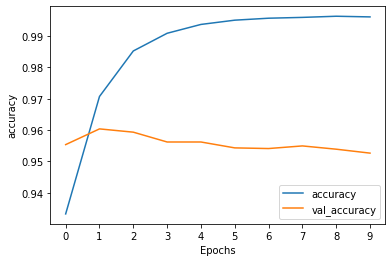

In [196]:
# YOUR CODE HERE
plot_graphs(history, 'accuracy')



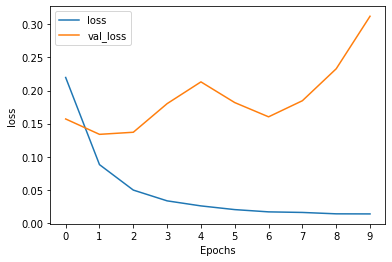

In [197]:
# YOUR CODE HERE
plot_graphs(history, 'loss')

7. The model starts to overfit after a couple of epochs. 
Consider using [early stopping](https://www.tensorflow.org/api_docs/python/tf/keras/callbacks/EarlyStopping) to stop training when a monitored metric has stopped improving. 

  What can we do to tame overfitting?

    YOUR ANSWER HERE Reduce the model's complexity: A model that is too complex can overfit the data, so reducing the number of layers, nodes, or parameters can help to reduce overfitting. 
    Use regularization techniques: Regularization techniques such as L1, L2, and dropout can help to reduce overfitting by constraining the weights of the model.
    Increase the amount of training data: Overfitting can occur when the model is trained on a small amount of data. Increasing the amount of data can help to reduce overfitting.
    Data augmentation: If it is difficult to collect more training data, data augmentation techniques such as rotation, cropping, and flipping can be used to create new training samples.
    Early stopping: As the model overfits the training data, the validation loss may begin to increase. By monitoring the validation loss, we can use early stopping to stop training the model when the validation loss stops improving.

8. Print the classification report of the model on test dataset. 

In [203]:

# predict the labels for the test set
y_pred_lstm = model.predict(X_test)

# convert the predicted probabilities to binary labels (0 or 1)
y_pred_binary = (y_pred_lstm > 0.5).astype(int)

250/250 [==============================] - 2s 6ms/step


In [204]:
# YOUR CODE HERE
# print the classification report
target_names = ['class 0', 'class 1']
print(classification_report(y_test, y_pred_binary, target_names=target_names))

              precision    recall  f1-score   support

     class 0       0.97      0.97      0.97      7430
     class 1       0.65      0.63      0.64       561

    accuracy                           0.95      7991
   macro avg       0.81      0.80      0.81      7991
weighted avg       0.95      0.95      0.95      7991



9. Discuss: how does the BiLSTM model improve the classification over naive Bayes? 

    YOUR ANSWER HERE
    The classification report for the BiLSTM model shows a higher precision, recall, and f1-score for class 1 (the minority class) compared to the naive Bayes model. This indicates that the BiLSTM model is better at identifying tweets related to disaster events, which is the objective of the classification task. The accuracy for the BiLSTM model is also higher than the naive Bayes model, which further supports the improvement in classification performance. Overall, the BiLSTM model shows better performance in identifying disaster-related tweets and provides a more accurate classification compared to naive Bayes.

In [ ]:
# # NB using tf-idf
#               precision    recall  f1-score   support

#            0       0.96      0.97      0.97      7430
#            1       0.55      0.48      0.51       561

#     accuracy                           0.94      7991
#    macro avg       0.75      0.72      0.74      7991
# weighted avg       0.93      0.94      0.93      7991

# # NB using word2vec
#               precision    recall  f1-score   support

#            0       0.98      0.85      0.91      7430
#            1       0.29      0.82      0.43       561

#     accuracy                           0.85      7991
#    macro avg       0.64      0.83      0.67      7991
# weighted avg       0.94      0.85      0.88      7991

10. Visualize embeddings using [Embedding Projector](https://www.tensorflow.org/tensorboard/tensorboard_projector_plugin) in Tensorboard. 
The setup for Tensorboard can be tricky, most of the code is provided. 

    TensorBoard reads tensors and metadata from the logs of your tensorflow projects. 
    The path to the log directory is specified with log_dir below. 
    
    In order to load the data into Tensorboard, we need to save a training checkpoint to that directory, along with metadata that allows for visualization of a specific layer of interest in the model.

    Load the TensorBoard notebook extension and import `projector` from `tensorboard.plugins`.

In [217]:
%load_ext tensorboard

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


In [218]:
from tensorboard.plugins import projector

11. Clear any logs from previous runs if any.

In [219]:
rm -rf /logs/  

12. Set up a logs directory, so Tensorboard knows where to look for data.

In [220]:
import os
log_dir='/logs/tweets-example/'
if not os.path.exists(log_dir):
    os.makedirs(log_dir)

13. Save the first `VOCAB_SIZE` most frequent words in the vocabulary as `metadata.tsv`.

In [221]:
with open(os.path.join(log_dir, 'metadata.tsv'), "w") as f:
  i = 0
  for label in tokenizer.word_index.keys():
    if label == 'oov':
      continue # skip oov
    f.write("{}\n".format(label))
    if i > VOCAB_SIZE:
      break
    i += 1

14. Save the weights we want to analyze as a variable. Note that the first value represents any unknown word, which is not in the metadata, here we will remove this value.

In [222]:
weights = tf.Variable(model.layers[0].get_weights()[0][1:]) # `embeddings` has a shape of (num_vocab, embedding_dim) 

15. Create a checkpoint from embedding, the filename and key are the name of the tensor.

In [223]:
checkpoint = tf.train.Checkpoint(embedding=weights)
checkpoint.save(os.path.join(log_dir, "embedding.ckpt"))

'/logs/tweets-example/embedding.ckpt-1'

16. Set up config.

In [224]:
config = projector.ProjectorConfig()
embedding = config.embeddings.add()

17. The name of the tensor will be suffixed by `/.ATTRIBUTES/VARIABLE_VALUE`.

In [225]:
embedding.tensor_name = "embedding/.ATTRIBUTES/VARIABLE_VALUE"
embedding.metadata_path = 'metadata.tsv'
projector.visualize_embeddings(log_dir, config)

18. Verify the following files exist under the current directory

In [226]:
ls /logs/tweets-example/

checkpoint                            metadata.tsv
embedding.ckpt-1.data-00000-of-00001  projector_config.pbtxt
embedding.ckpt-1.index


19. Now run Tensorboard against on log data we just saved. 

    You may need to run this cell **twice** to see the projector correctly. 
    Use Chrome for least friction.

In [227]:
%tensorboard --logdir /logs/tweets-example/

Reusing TensorBoard on port 6006 (pid 39046), started 0:01:25 ago. (Use '!kill 39046' to kill it.)

<IPython.core.display.Javascript object>

The TensorBoard Projector can be a great tool for interpreting and visualzing embedding. The dashboard allows users to search for specific terms, and highlights words that are adjacent to each other in the embedding (low-dimensional) space. Try a few word in the Search box and see if the embeddings make sense. 

# Task 6. Interpretation

Lastly let's try to understnad predictions by BiLSTM using a model agnostic approach -- [Local interpretable model-agnostic explanations (LIME)](https://christophm.github.io/interpretable-ml-book/lime.html)

1. Import `LimeTextExplainer` from the [`lime_text`](https://lime-ml.readthedocs.io/en/latest/lime.html#module-lime.lime_text) module in package [`lime`](https://github.com/marcotcr/lime)

In [228]:
from lime.lime_text import LimeTextExplainer

2. Create an instance of `LimeTextExplainer`, call it `explanier`. 

In [229]:
explainer = LimeTextExplainer(class_names=['no', 'yes'], random_state=2)

3. Method `explain_instance` expects the `classifier_fn` to be a function, we provide the function `predict_proba` as below. 

In [239]:
def predict_proba(arr):
    processed = tokenizer.texts_to_sequences(arr)
    processed = pad_sequences(processed, padding='post', maxlen=MAX_LEN)
    pred = model.predict(processed)
    r = []
    for i in pred:
        temp = i[0]
        r.append(np.array([1-temp,temp])) 
    return np.array(r)

4. Read about [`explain_instance`](https://lime-ml.readthedocs.io/en/latest/lime.html#lime.lime_text.LimeTextExplainer.explain_instance). 

    Create an instance named `exp` to explain the 16399th tidy tweet from the original dataset, i.e., `raw.tidy_tweet.iloc[16399]`. 

In [244]:
idx = 16399

# Get the text of the tweet
text = raw.tidy_tweet.iloc[idx]

# Preprocess the text
text_sequence = tokenizer.texts_to_sequences([text])
text_sequence = pad_sequences(text_sequence, maxlen=MAX_LEN, padding='post', truncating='post')

# Define a function that predicts the class of the input text using the trained BiLSTM model
def predict_fn(texts):
    sequences = tokenizer.texts_to_sequences(texts)
    sequences = pad_sequences(sequences, maxlen=MAX_LEN, padding='post', truncating='post')
    return model.predict(sequences)

# Define a wrapper function that returns the predicted class probabilities
def predict_wrapper(texts):
    probs = predict_fn(texts)
    return np.hstack([1-probs, probs])

# Create an explainer instance
explainer = LimeTextExplainer(class_names=['class 0', 'class 1'])

# Create an explanation for the tweet
exp = explainer.explain_instance(text, predict_wrapper, num_features=6)

# Show the explanation in a notebook
exp.show_in_notebook(text=text)


157/157 [==============================] - 1s 5ms/step


5. Pick another random tweet and generate explanations for the prediction.

In [245]:
# YOUR CODE HERE
# pick a random index
idx = np.random.randint(len(raw))

# get the text of the tweet
text = raw.tidy_tweet.iloc[idx]

# generate an explanation for the prediction using the BiLSTM model
exp = explainer.explain_instance(text, predict_wrapper, num_features=6)

# show the explanation in a notebook
exp.show_in_notebook(text=text)

157/157 [==============================] - 1s 3ms/step


6. Jot down your observations in explaining the model. 

    YOUR ANSWER HERE  Based on the highlighted words, it appears that the model is associating the tweet with negative sentiment and potentially offensive language. The words "horrif," and "straight goblin" are likely contributing to the negative sentiment prediction, while "ignor" and "fashio" are potentially offensive words. The model may be picking up on the overall tone of the tweet as well as specific keywords. It's also possible that the model is overfitting to certain types of language or topics that are commonly associated with negative sentiment or offensive language. 

# Acknowledgement & Reference

- Data is adapted from [Twitter sentiment analysis](https://datahack.analyticsvidhya.com/contest/practice-problem-twitter-sentiment-analysis/#ProblemStatement)
- [Twitter sentiment analysis](https://github.com/prateekjoshi565/twitter_sentiment_analysis/blob/master/code_sentiment_analysis.ipynb) 
- [Introduction to Word Embedding and Word2Vec](https://towardsdatascience.com/introduction-to-word-embedding-and-word2vec-652d0c2060fa)
- [When to use GRU over LSTM?](https://datascience.stackexchange.com/questions/14581/when-to-use-gru-over-lstm)
- Use a trained Word2Vec, Doc2Vec or FastTest embedding by `gensim` in buiding an embedding layers in Tensorflow, here's [how-to](https://github.com/RaRe-Technologies/gensim/wiki/Using-Gensim-Embeddings-with-Keras-and-Tensorflow).